In [1]:
%matplotlib qt

import numpy as np
import matplotlib.pyplot as plt

# za animiran izris
from IPython.display import HTML
from matplotlib import animation

# Vzorčenje in Nyquistov teorem

## Animiran izris sinusoide pri različnih fazah

In [2]:
# parametri funkcije
Fvz = 20 # frekvenca vzorčenja (v Hz)
Fvz_cont = Fvz*100 # frekvenca vzorčenja za signal, ki je simulacija zveznega signala
T = 1 # dolžina signala v sekundah
t = np.arange(0, T * Fvz, 1) / Fvz # vektor časovnih indeksov
t_cont = np.arange(0, T*Fvz_cont, 1)/Fvz_cont
f = 3 # frekvenca sinusoide
A = 1 # amplituda sinusoide
faza = 0.0 # faza sinusoide

# izracun/generiranje signalov
# to je vzorčen signal
s = A * np.sin(2 * np.pi * f * t + faza * np.pi) 
# to je tudi vzorčen signal, ampak pri precej višji vzorčevalni frekvenci,
# zato služi kot približek zveznega signala
s_cont = A * np.sin(2 * np.pi * f * t_cont + faza * np.pi) 
        

# pripravi graf za risanje
fig, ax = plt.subplots()

ax.set_xlim((0, 1))
ax.set_ylim((-1, 1))
ax.set_ylabel('amplituda')
ax.set_xlabel('čas (s)')

# izris za zvezni signal
l_cont, = ax.plot(t_cont, s_cont, linewidth=2.0, color='gray', label='zvezni signal')
# izris za vzorcen signal
l_samp = ax.stem(t, s, linefmt='r', markerfmt='r', label='vzorčen signal')
plt.legend(loc='upper right')

# funkcija za izračun posamezne slike animacije
def animate(faza):
    # ponovno izracunamo oba signala pri drugi fazi
    s = A * np.sin(2 * np.pi * f * t + faza * np.pi)
    s_cont = A * np.sin(2 * np.pi * f * t_cont + faza * np.pi)

    # posodobimo podatke izrisa zveznega signala
    l_cont.set_data(t_cont, s_cont)

    # posodobimo podatke izrisa vzorcenega signala
    l_samp[0].set_data(t, s)
    line_segs = l_samp[1].get_segments()
    for line_seg, v in zip(line_segs, s):
        line_seg[1, 1] = v
    l_samp[1].set_segments(line_segs)


    ax.set_title('Fvz = %d Hz, Frekvenca = %.2f Hz, faza = %.2f' % (Fvz, f, faza))
    return l_samp + (l_cont,)


# matplotlib animator (graf, funkcija za izračun/izris, začetni izris,
#                      poslana spremenljivka za posamezen izračun/izris, čas med izrisom(ms), izriši samo spremenjene dele)
ani = animation.FuncAnimation(fig, animate,
                              frames=np.arange(0, 6, 0.05), interval=50, blit=False, repeat=False)


In [3]:
# prikaži animiran izris
HTML(ani.to_jshtml())

## Animiran izris sinusoide pri različnih frekvencah

In [6]:
# parametri funkcije
Fvz = 20 # frekvenca vzorčenja (v Hz)
Fvz_cont = Fvz*100 # frekvenca vzorčenja za signal, ki je simulacija zveznega signala
T = 1 # dolžina signala v sekundah
t = np.arange(0, T * Fvz, 1) / Fvz # vektor časovnih indeksov
t_cont = np.arange(0, T*Fvz_cont, 1)/Fvz_cont
f = 0 # frekvenca sinusoide
A = 1 # amplituda sinusoide
faza = 0 # faza sinusoide

# to je vzorčen signal
s = A * np.sin(2 * np.pi * f * t + faza * np.pi) 
# to je tudi vzorčen signal, ampak pri precej višji vzorčevalni frekvenci,
# zato služi kot približek zveznega signala
s_cont = A * np.sin(2 * np.pi * f * t_cont + faza * np.pi) 
        

# pripravi graf za risanje
fig, ax = plt.subplots()

ax.set_xlim((0, 1))
ax.set_ylim((-1, 1))
ax.set_ylabel('amplituda')
ax.set_xlabel('čas (s)')

# izris za zvezni signal
l_cont, = ax.plot(t_cont, s_cont, linewidth=2.0, color='gray', label='zvezni signal')
# izris za vzorcen signal
l_samp = ax.stem(t, s, linefmt='r', markerfmt='r', label='vzorčen signal')
plt.legend(loc='upper right')


# funkcija za izris posamezne slike animacije
def animate(f):
    # to je vzorčen signal
    s = A * np.sin(2 * np.pi * f * t + faza * np.pi) 
    # to je tudi vzorčen signal, ampak pri precej višji vzorčevalni frekvenci,
    # zato služi kot približek zveznega signala
    s_cont = A * np.sin(2 * np.pi * f * t_cont + faza * np.pi)

    # posodobimo podatke izrisa zveznega signala
    l_cont.set_data(t_cont, s_cont)

    # posodobimo podatke izrisa vzorcenega signala
    l_samp[0].set_data(t, s)
    line_segs = l_samp[1].get_segments()
    for line_seg, v in zip(line_segs, s):
        line_seg[1, 1] = v
    l_samp[1].set_segments(line_segs)

    ax.set_title('Fvz = %d Hz, Frekvenca = %.2f Hz, faza = %.2f' % (Fvz, f, faza))
    return l_samp + (l_cont,)


# matplotlib animator (graf, funkcija za izračun/izris, začetni izris,
#                      poslana spremenljivka za posamezen izračun/izris, čas med izrisom(ms), izriši samo spremenjene dele)
ani = animation.FuncAnimation(fig, animate,
                              frames=np.arange(0, 2 * Fvz, 0.25), interval=50, blit=False, repeat=False)


In [7]:
# prikaži animiran izris
HTML(ani.to_jshtml())

## Animiran izris sinusoide pri različnih bitnih ločljivostih

In [8]:
# parametri funkcije
Fvz = 20 # frekvenca vzorčenja (v Hz)
Fvz_cont = Fvz*100 # frekvenca vzorčenja za signal, ki je simulacija zveznega signala
T = 1 # dolžina signala v sekundah
t = np.arange(0, T * Fvz, 1) / Fvz # vektor časovnih indeksov
t_cont = np.arange(0, T*Fvz_cont, 1)/Fvz_cont
f = 1 # frekvenca sinusoide
A = 1 # amplituda sinusoide
faza = 0 # faza sinusoide

# to je vzorčen signal
s = A * np.sin(2 * np.pi * f * t + faza * np.pi) 
# to je tudi vzorčen signal, ampak pri precej višji vzorčevalni frekvenci,
# zato služi kot približek zveznega signala
s_cont = A * np.sin(2 * np.pi * f * t_cont + faza * np.pi) 

# pripravi graf za risanje
fig, ax = plt.subplots()

ax.set_xlim((0, 1))
ax.set_ylim((-1, 1))
ax.set_ylabel('amplituda')
ax.set_xlabel('čas (s)')

# izris za zvezni signal
l_cont, = ax.plot(t_cont, s_cont, linewidth=2.0, color='gray', label='zvezni signal')
# izris za vzorcen signal
l_samp = ax.stem(t, s, linefmt='r', markerfmt='r', label='vzorčen signal')
plt.legend(loc='upper right')

# funkcija za izris posamezne slike animacije
def animate(bit):
    # to je vzorčen signal
    s = A * np.sin(2 * np.pi * f * t + faza * np.pi) 
    # to je tudi vzorčen signal, ampak pri precej višji vzorčevalni frekvenci,
    # zato služi kot približek zveznega signala
    s_cont = A * np.sin(2 * np.pi * f * t_cont + faza * np.pi)

    s_bit = np.round((s+1)/2*(2**bit-1)-2**(bit-1))
    s_bit_norm = s_bit/2**(bit-1)

    # posodobimo podatke izrisa zveznega signala
    l_cont.set_data(t_cont, s_cont)

    # posodobimo podatke izrisa vzorcenega signala
    l_samp[0].set_data(t, s_bit_norm)
    line_segs = l_samp[1].get_segments()
    for line_seg, v in zip(line_segs, s_bit_norm):
        line_seg[1, 1] = v
    l_samp[1].set_segments(line_segs)

    ax.set_title(f'Fvz = {Fvz:d} Hz, Frekvenca = {f:.2f} Hz, faza = {faza:.2f}, bitna ločljivost = {bit:d}')
    return l_samp + (l_cont,)


#plt.show()

# matplotlib animator (graf, funkcija za izračun/izris, začetni izris,
#                      poslana spremenljivka za posamezen izračun/izris, čas med izrisom(ms), izriši samo spremenjene dele)
ani = animation.FuncAnimation(fig, animate,
                              frames=[12, 10, 8, 7, 6, 5, 4, 3, 2], interval=1000, blit=False, repeat=False)

In [10]:
# prikaži animiran izris
HTML(ani.to_jshtml())

## Izris sinusoid s frekvenco `f` in frekvenco `Fvz-f`

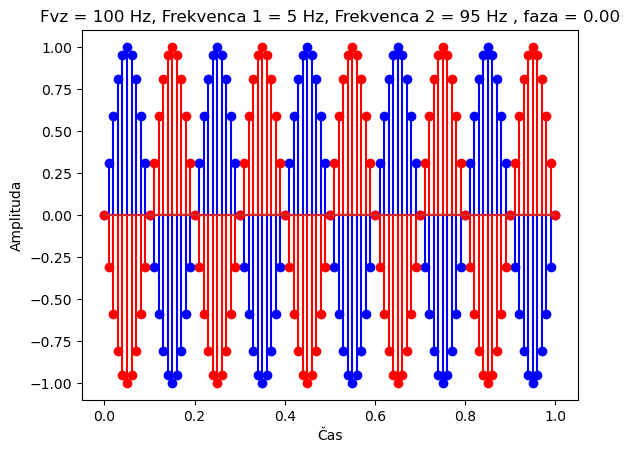

In [11]:
# parametri funkcije
Fvz = 100 # frekvenca vzorčenja (v Hz)
T = 1 # dolžina signala v sekundah
t = np.arange(0, T * Fvz + 1, 1) / Fvz # vektor časovnih indeksov
A = 1 # amplituda sinusoide
faza = 0.0 # faza sinusoide
f1 = 5
s1 = A * np.sin(2 * np.pi * f1 * t + faza * np.pi)
f2 = Fvz - f1
s2 = A * np.sin(2 * np.pi * f2 * t + faza * np.pi)

fig = plt.figure()
plt.stem(t, s1, 'b')
plt.stem(t, s2, 'r')
plt.xlabel('Čas')
plt.ylabel('Amplituda')
plt.title('Fvz = %d Hz, Frekvenca 1 = %d Hz, Frekvenca 2 = %d Hz , faza = %.2f' % (Fvz, f1, f2, faza))
plt.show()

fig


## Interpolacija sinusoide

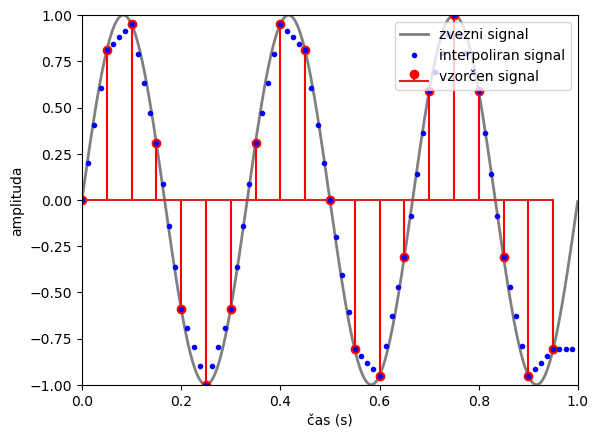

In [12]:
# parametri funkcije
Fvz = 20 # frekvenca vzorčenja (v Hz)
Fvz_cont = Fvz*100 # frekvenca vzorčenja za signal, ki je simulacija zveznega signala
T = 1 # dolžina signala v sekundah
t = np.arange(0, T * Fvz, 1) / Fvz # vektor časovnih indeksov
t_cont = np.arange(0, T*Fvz_cont, 1)/Fvz_cont
f = 3 # frekvenca sinusoide
A = 1 # amplituda sinusoide
faza = 0 # faza sinusoide

# to je vzorčen signal
s = A * np.sin(2 * np.pi * f * t + faza * np.pi) 
# to je tudi vzorčen signal, ampak pri precej višji vzorčevalni frekvenci,
# zato služi kot približek zveznega signala
s_cont = A * np.sin(2 * np.pi * f * t_cont + faza * np.pi) 


# interpolirajmo signal s
# časovni trenutki interpolacije
t_int = np.arange(0, T*Fvz*4, 1)/(Fvz*4)
# interpolacija
s_int = np.interp(t_int, t, s)


# pripravi graf za risanje
fig, ax = plt.subplots()

ax.set_xlim((0, 1))
ax.set_ylim((-1, 1))
ax.set_ylabel('amplituda')
ax.set_xlabel('čas (s)')

# izris za zvezni signal
l_cont, = ax.plot(t_cont, s_cont, linewidth=2.0, color='gray', label='zvezni signal')
# izris za vzorcen signal
l_samp = ax.stem(t, s, linefmt='r', markerfmt='r', label='vzorčen signal')
# izris za interpoliran signal
l_samp = ax.plot(t_int, s_int,'b.', label='interpoliran signal')

plt.legend(loc='upper right')
fig

## Vzorčenje zvoka

In [13]:
import sounddevice as sd

In [16]:
# zvorčenje zvoka

Fvz = 44100 # vzorčevalna frekvenca
T = 5 # dolžina signala v sekundah
bres = 'int16' # bitna ločljivost (float64, float32, int32, int16, int8, uint8)
nchans = 1 # 1 (mono), 2 (stereo)

posnetek = sd.rec(int(T * Fvz), samplerate=Fvz, channels=nchans, dtype=bres)
sd.wait()

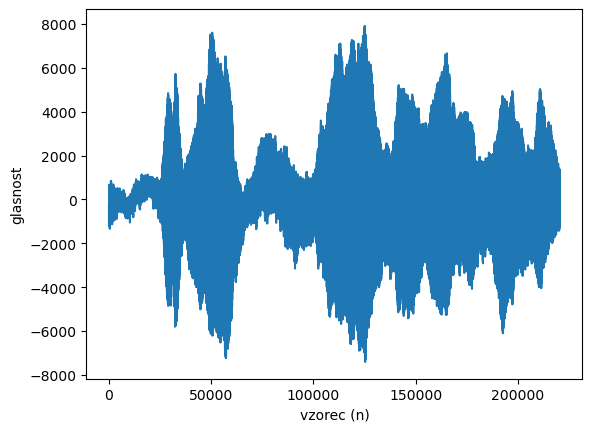

In [19]:
# izris zvoka
fig ,ax = plt.subplots()
ax.plot(posnetek)
ax.set_xlabel('vzorec (n)')
ax.set_ylabel('glasnost')

fig

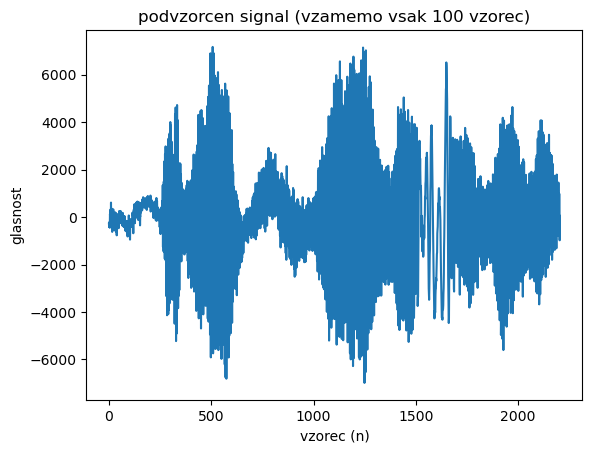

In [25]:
# izris zvoka
fig ,ax = plt.subplots()
ax.set_title('podvzorcen signal (vzamemo vsak 100 vzorec)')
ax.plot(posnetek[::100])
ax.set_xlabel('vzorec (n)')
ax.set_ylabel('glasnost')

fig

In [26]:
# normalizacija zvoka

posnetek = posnetek / np.max(np.abs(posnetek))

fig ,ax = plt.subplots()
ax.plot(posnetek)
ax.set_xlabel('vzorec (n)')
ax.set_ylabel('glasnost')

Text(0, 0.5, 'glasnost')

In [33]:
# predvajanje zvoka

#sd.play(posnetek, Fvz)
# kaj ce predvajalniku povemo, da je frekvenca vzorcenja bila nizja?
#sd.play(posnetek, Fvz / 2)
# ali pa visja?
#sd.play(posnetek, Fvz * 4)
# kaj ce vzamemo samo nekaj vzorcev, in primerno spremenimo vzorcevalno frekvenco?
#sd.play(posnetek[::10], Fvz/10)


In [34]:
sd.stop()

In [39]:
# sprememba faze, ali jo zaznate?

Fvz = 44100
T = 3
t = np.arange(0, T * Fvz + 1, 1) / Fvz
f = 250
A = 1.0
faza = 0.0 # faza sinusoide - spreminjajte jo med 0.0 in 2.0

s = A * np.sin(2 * np.pi * f * t + faza * np.pi)

sd.play(s, Fvz)

In [40]:
sd.stop()

In [45]:
# kršenje Nyquista, ali zaznate zvok netopirja?

Fvz = 44100
T = 3
t = np.arange(0, T * Fvz + 1, 1) / Fvz
fnetopir = 90000
A = 1.0
faza = 2.0 # faza sinusoide - sprminajjte jo med 0.0 in 2.0

s = A * np.sin(2 * np.pi * fnetopir * t + faza * np.pi)

sd.play(s, Fvz)


In [46]:
sd.stop()

# Slike

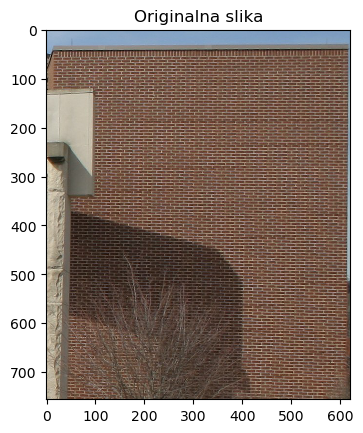

In [51]:
# nalaganje in prikaz slike
slika = plt.imread('Moire.jpg')

fig, ax = plt.subplots()
ax.imshow(slika, interpolation='none')
ax.set_title('Originalna slika')

fig

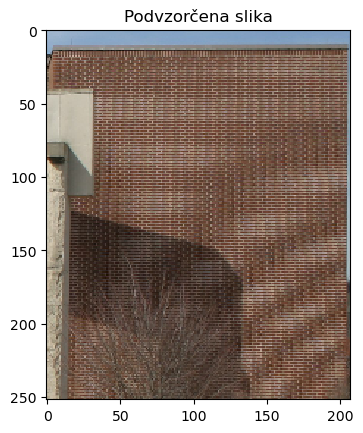

In [50]:
# podvzorčenje slike - diskretizacija (spreminajnje resolucije)

faktor = 3 # faktor podvzorčenja

fig, ax = plt.subplots()
ax.imshow(slika[1:-1:faktor,1:-1:faktor,:], interpolation='none')
ax.set_title('Podvzorčena slika')

fig

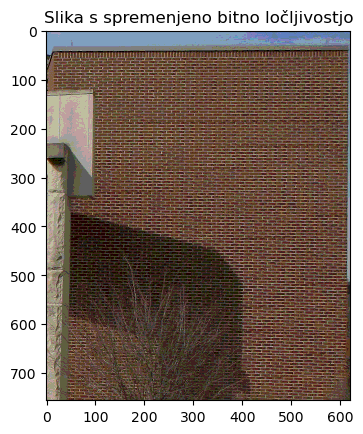

In [54]:
# podvzorčenje slike - kvantizacija (spreminjanje bitne ločljivosti)

bres = 3 # bitna ločljivost

fig, ax = plt.subplots()
ax.imshow((slika[:,:,:]>>(8-bres))/(256>>8-bres), interpolation='none')
ax.set_title('Slika s spremenjeno bitno ločljivostjo')

fig